## Tracking over days
Are fragmented cells across sessions the same set?

Apr 21, 2025

In [5]:
%load_ext autoreload
%autoreload 2

In [6]:
import os
import numpy as np
import datajoint as dj
import spyglass as nd
import pandas as pd
import matplotlib.pyplot as plt

In [58]:
from spyglass.shijiegu.helpers import interval_union
from spyglass.shijiegu.Analysis_SGU import TrialChoice,RippleTimes,EpochPos,ExtendedRippleTimes,RippleTimesWithDecode
from spyglass.shijiegu.load import load_run_sessions
from spyglass.shijiegu.singleUnit import (do_mountainSort,electrode_unit,RippleTime2FiringRate,findWaveForms,RippleTime2Index,
                            )
from spyglass.shijiegu.fragmented import permute_frag_cont,find_spike_count_ratio,get_nwb_units
from spyglass.spikesorting.v0.spikesorting_curation import QualityMetrics
from spyglass.shijiegu.placefield import place_field
from spyglass.shijiegu.curation_manual import load_peak_amp, plot_spray_window, show_plot

#### day and sessions

In [8]:
nwb_copy_file_name = "lewis20240109_.nwb"
#nwb_copy_file_name = "eliot20221021_.nwb"

In [9]:
run_session_ids, run_session_names, pos_session_names = load_run_sessions(nwb_copy_file_name)

*nwb_file_name *epoch    epoch_name     position_inter
+------------+ +-------+ +------------+ +------------+
lewis20240109_ 1         01_Rev2Sleep1  pos 0 valid ti
lewis20240109_ 2         02_Rev2Session pos 1 valid ti
lewis20240109_ 3         03_Rev2Sleep2  pos 2 valid ti
lewis20240109_ 4         04_Rev2Session pos 3 valid ti
lewis20240109_ 5         05_Rev2Sleep3  pos 4 valid ti
lewis20240109_ 6         06_Rev2Session pos 5 valid ti
lewis20240109_ 7         07_Rev2Sleep4  pos 6 valid ti
lewis20240109_ 8         08_Rev2Session pos 7 valid ti
lewis20240109_ 9         09_Rev2Sleep5  pos 8 valid ti
 (Total: 9)



In [10]:
epoch_num1 = 0
epoch_num2 = 1

#### load ripple times

In [11]:
session_name1 = run_session_names[epoch_num1]
pos_name1 = pos_session_names[epoch_num1]

session_name2 = run_session_names[epoch_num2]
pos_name2 = pos_session_names[epoch_num2]

print(session_name1, session_name2)
print(pos_name1,pos_name2)

02_Rev2Session1 04_Rev2Session2
pos 1 valid times pos 3 valid times


In [12]:
ripple_times_all = []
for session_name in [session_name1, session_name2]:
    try:
        ripple_times = pd.DataFrame((RippleTimesWithDecode & 
                                 {'nwb_file_name': nwb_copy_file_name, 'interval_list_name': session_name}).fetch1('ripple_times'))
    except:
        ripple_times = pd.read_pickle((RippleTimesWithDecode & 
                                 {'nwb_file_name': nwb_copy_file_name, 'interval_list_name': session_name}).fetch1('ripple_times'))
    ripple_times_all.append(ripple_times)
ripple_times1, ripple_times2 = ripple_times_all

In [13]:
ripple_times1

,event_number,start_time,animal_location,trial_number,cont_intvl,frag_intvl,cont_intvl_replay,end_time,duration,mean_zscore,median_zscore,max_zscore,min_zscore,max_speed,min_speed,median_speed,mean_speed
0,1,1.704828e+09,home,1,"[[1704827597.9726489, 1704827598.3506489], [17...",[],"[[1], [], []]",1.704828e+09,0.888002,NaN,NaN,NaN,NaN,0.056401,0.056400,0.056401,0.056401
1,2,1.704828e+09,home,1,"[[1704827600.6606483, 1704827601.6366482]]",[],[[0]],1.704828e+09,0.978003,0.810976,0.611720,4.902610,-0.375640,0.056401,0.056400,0.056400,0.056400
2,3,1.704828e+09,home,2,"[[1704827604.0486476, 1704827604.6286476]]",[],[[0]],1.704828e+09,0.582001,0.760839,0.589124,3.114255,-0.577900,0.056401,0.056400,0.056401,0.056401
3,4,1.704828e+09,home,2,"[[1704827609.058647, 1704827609.5626466]]",[],[[3]],1.704828e+09,0.507000,0.681824,0.402497,5.263690,-0.222113,0.056401,0.056400,0.056400,0.056401
4,5,1.704828e+09,home,2,"[[1704827618.1426451, 1704827618.518645]]",[],[[3]],1.704828e+09,0.378000,0.801214,0.696467,2.890186,-0.390811,0.056401,0.056400,0.056401,0.056401
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
176,177,1.704830e+09,well2,79,"[[1704829887.8602166, 1704829888.0642166]]",[],[[2]],1.704830e+09,0.263000,NaN,NaN,NaN,NaN,4.355190,1.452820,2.552299,2.738933
177,178,1.704830e+09,well2,79,"[[1704829893.8662157, 1704829893.9742155], [17...",[],"[[2], [2], [], [], [1, 2]]",1.704830e+09,0.431000,0.548005,0.321112,4.219078,-1.270932,0.865008,0.849712,0.849731,0.850826
178,179,1.704830e+09,home,80,"[[1704829906.4822133, 1704829906.6222131], [17...","[[1704829906.6242132, 1704829906.6742132], [17...","[[0], [], [], [], [], [], [], [], []]",1.704830e+09,1.083003,2.654417,1.657991,17.545821,-1.294060,0.980884,0.980081,0.980876,0.980854
179,180,1.704830e+09,home,81,"[[1704829932.866208, 1704829932.9662082], [170...","[[1704829933.176208, 1704829933.308208], [1704...","[[4], [], [], []]",1.704830e+09,0.610001,NaN,NaN,NaN,NaN,0.816311,0.809055,0.816303,0.815865


#### determine fragmented cells

In [15]:
def find_fragmented_cells(nwb_copy_file_name, session_name, pos_name,
                          ripple_times, curation_id = 1, threshold = 5, use_rate = False):

    curation_id = 1
    key = {"nwb_file_name": nwb_copy_file_name,
           "sorter":"mountainsort4",
           "sort_interval_name":session_name}
    
    sort_group_ids_with_good_cell = []
    sort_group_ids = np.unique((QualityMetrics & key).fetch("sort_group_id"))
    for sort_group_id in sort_group_ids:
        nwb_units = electrode_unit(nwb_copy_file_name,session_name,sort_group_id,curation_id = curation_id)
        
        #print("\n here")
        if nwb_units is None or len(nwb_units)==0:
            #print("\nhere", sort_group_id)
            continue
        print(len(nwb_units))
        sort_group_ids_with_good_cell.append(sort_group_id)
    print(sort_group_ids_with_good_cell)

    nwb_units_all = get_nwb_units(nwb_copy_file_name,session_name,sort_group_ids_with_good_cell,curation_id = curation_id)

    ratio, ratio_dict, firing_rate_F, firing_rate_C, unit_name = find_spike_count_ratio(nwb_units_all,
                                                                                        ripple_times, use_rate = use_rate)

    candidates = []
    placefields = {}
    peak_frs = {}
    mobility_spike_counts = {}
    all_spike_counts = {}
    ratios = {}

    for unit in unit_name:
        (e, u) = unit
        placefield, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name, pos_name, e, u)

        if all_spike_count < 10:
            continue
        if ratio_dict[unit] >= threshold:
            candidates.append(unit)
            placefields[unit] = placefield
            peak_frs[unit] = peak_fr
            mobility_spike_counts[unit] = mobility_spike_count
            all_spike_counts[unit] = all_spike_count
            ratios[unit] = ratio_dict[unit]
            
    return candidates, placefields, peak_frs, mobility_spike_counts, all_spike_counts, ratio_dict, sort_group_ids_with_good_cell

In [16]:
use_rate = True
(candidates1, placefields1,
 peak_frs1, mobility_spike_counts1, all_spike_counts1, ratios1, all_sort_groups1) = find_fragmented_cells(
     nwb_copy_file_name, session_name1, pos_name1, ripple_times1, curation_id = 1, use_rate = use_rate)

/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


4


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


7


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


7


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


2


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


10


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


7


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


7


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


10


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


12


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


16


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


11


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


15


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


13


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6
[0, 1, 3, 7, 8, 9, 10, 12, 13, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31, 32, 35, 37, 39, 40, 42, 43, 44, 46, 47, 48, 50, 53, 58, 61, 62, 63]


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4596


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignori

spike num: 2451


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 793


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3011


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 98


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1003


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 339


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1022


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 573


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 817


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 78


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 135


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1583


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1006


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 131


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 636


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1839


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 61


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 395


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 102


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 306


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2545


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 674


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1532


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6018


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1284


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 534


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1721


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 642


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 341


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2109


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4954


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1689


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 573


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 303


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 861


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 12209


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 655


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1420


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 627


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 132


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1186


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 926


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1330


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1229


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5119


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1475


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1176


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1102


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 439


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 142


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 117


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1079


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1372


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1876


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 371


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1818


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 98


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1278


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 764


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 321


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 862


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 54


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 541


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2804


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1017


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 678


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1264


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1626


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 190


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1234


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 233


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 56


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 139


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 141


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1423


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 11826


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1418


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1448


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 848


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1914


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 179


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1355


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1200


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1481


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1370


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 48


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 373


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 69


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3430


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6470


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 782


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 82


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 281


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2055


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 172


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2997


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5127


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4291


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4306


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 473


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1281


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 230


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 384


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3570


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2022


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 140


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 142


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 520


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1328


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 823


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 126


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1012


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 717


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 358


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1135


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 881


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6045


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 305


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 892


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2032


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 588


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 289


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 586


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 162


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1571


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1437


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 46


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4818


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 443


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 116


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 348


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 654


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1290


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 572


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1390


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 92


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 815


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 404


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 272


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 570


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1279


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 791


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 64


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1268


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 178


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1313


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 964


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1903


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2114


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 314


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1910


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 705


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 288


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 23


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 245


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 742


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 60


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4107


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3195


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 985


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 302


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2531


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 959


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1333


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 449


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1182


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 617


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1893


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 246


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 67


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 900


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 587


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 675


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 603


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 384


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3829


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2149


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 620


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 401


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 130


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 229


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 534


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2244


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 848


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2346


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 41


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 643


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 360


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1251


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2480


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 818


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 994


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1237


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 879


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 488


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 725


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1015


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 438


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1670


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 299


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 132


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 237


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1009


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3789


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 401


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1138


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 473


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2099


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 336


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 622


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 32


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 217


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2072


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1433


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 397


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 130


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 362


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3002


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 651


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 575


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 760


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 634


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3148


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 466


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2230


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2312


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1217


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 8346


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1522


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 12824


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 175


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 941


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 77


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3868


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 885


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 457


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 149


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3637


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 96


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 90


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2508


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 375


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2683


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3846


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1564


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3737


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1412


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 271


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 765


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 133


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 151


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 916


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 351


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3569


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2568


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 751


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1808


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 366


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 252


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 641


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 833


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 174


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1686


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3151


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1977


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 932


In [17]:
(candidates2, placefields2,
 peak_frs2, mobility_spike_counts2, all_spike_counts2, ratios2, all_sort_groups2) = find_fragmented_cells(
     nwb_copy_file_name, session_name2, pos_name2, ripple_times2, curation_id = 1, use_rate = use_rate)

/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


10


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


10


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


10


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


10


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


8


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


7


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


4


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


13


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


14


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


13


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


13


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


3


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


4


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


9


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


1


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


5


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


6


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."


4
[0, 3, 7, 8, 9, 10, 12, 13, 15, 17, 18, 19, 20, 21, 23, 24, 25, 26, 27, 29, 30, 31, 32, 35, 37, 39, 40, 42, 43, 44, 46, 47, 48, 50, 53, 58, 61, 62, 63]


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2631


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignori

spike num: 4322


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 576


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 662


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2137


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 146


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 746


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1442


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 113


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 180


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 137


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 625


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1650


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 566


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 587


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 526


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 924


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1594


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 388


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 76


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1706


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4466


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 643


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1759


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6268


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 403


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1029


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 725


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6033


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 534


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1845


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 317


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1244


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1747


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 395


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 647


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 452


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 384


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 347


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 112


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1253


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 576


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 87


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1529


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 606


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 714


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4309


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1496


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 939


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 816


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1332


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 205


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1115


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 11291


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 780


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 425


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 136


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2248


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1340


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 963


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 181


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 510


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1001


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1004


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 283


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 751


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2756


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 880


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 152


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1009


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 654


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1279


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 600


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 59


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 120


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 464


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1426


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 858


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 424


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2254


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 689


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 980


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1083


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1167


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1298


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 937


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 297


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 458


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4702


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6394


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 565


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 577


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1580


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 304


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4912


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4534


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 244


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2810


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5114


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 634


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 399


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2876


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1262


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 357


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 629


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1309


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1425


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2075


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 497


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 540


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 356


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 496


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 173


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 603


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5630


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 739


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1480


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1449


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 232


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 566


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 412


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 282


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2666


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 304


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 721


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4219


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1137


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1157


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 7612


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1135


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 862


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 794


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4422


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 162


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 809


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1029


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1282


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 134


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3811


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1906


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 953


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1197


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 380


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2102


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1843


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 226


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 542


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 126


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 58


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 416


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6958


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1084


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 376


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2659


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 702


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1063


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 625


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 216


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 48


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 400


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 658


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 231


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4473


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 636


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2931


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 835


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2568


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 433


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 261


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 406


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 581


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2087


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2107


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 372


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 421


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 547


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 33


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 440


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1448


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 701


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1176


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 476


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 401


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2306


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 551


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 9702


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 454


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 234


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 331


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1585


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 918


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1054


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 727


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 36


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 438


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1971


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 751


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3335


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4266


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 199


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 497


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 193


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 85


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2291


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1766


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 150


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1855


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 825


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 433


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 358


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2101


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 467


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2472


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 769


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 396


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1422


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 6943


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1149


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 900


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1288


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3178


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 666


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3837


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5507


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 970


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2172


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5111


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 122


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 376


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1332


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1757


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1859


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1944


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 3211


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 4012


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 400


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 537


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 1370


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 492


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2377


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 291


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 770


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 739


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 667


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 148


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'core' version 2.6.0-alpha because version 2.7.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/hdmf/spec/namespace.py:535: UserWarning: Ignoring cached namespace 'ndx-franklab-novela' version 0.1.0 because version 0.2.0 is already loaded.
  warn("Ignoring cached namespace '%s' version %s because version %s is already loaded."
/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 614


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 532


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 2079


/home/shijiegu/anaconda3/envs/spyglass/lib/python3.10/site-packages/spikeinterface/core/base.py:1038: UserWarning: Versions are not the same. This might lead to compatibility errors. Using spikeinterface==0.98.2 is recommended
  warnings.warn(


spike num: 5127


In [ ]:
peak_frs2

#### find common sort groups

In [18]:
sort_group_ids1 = np.unique(np.array(candidates1)[:,0])
sort_group_ids2 = np.unique(np.array(candidates2)[:,0])

In [19]:
sort_group_ids = np.intersect1d(sort_group_ids1,sort_group_ids2)
sort_group_ids_all = np.intersect1d(all_sort_groups1,all_sort_groups2)

In [20]:
candidates1

[(0, 5),
 (0, 7),
 (1, 7),
 (1, 8),
 (1, 9),
 (3, 3),
 (3, 7),
 (7, 4),
 (7, 6),
 (7, 13),
 (8, 8),
 (8, 10),
 (9, 3),
 (9, 4),
 (10, 12),
 (12, 3),
 (12, 4),
 (12, 8),
 (13, 5),
 (13, 12),
 (13, 13),
 (15, 5),
 (15, 7),
 (15, 18),
 (15, 19),
 (18, 6),
 (18, 9),
 (19, 11),
 (20, 4),
 (20, 16),
 (20, 18),
 (21, 4),
 (21, 7),
 (23, 4),
 (23, 13),
 (25, 4),
 (25, 11),
 (25, 15),
 (25, 17),
 (26, 6),
 (26, 15),
 (27, 9),
 (27, 11),
 (29, 4),
 (29, 8),
 (30, 13),
 (31, 11),
 (32, 5),
 (32, 7),
 (32, 15),
 (35, 7),
 (35, 9),
 (35, 14),
 (35, 16),
 (37, 2),
 (37, 3),
 (37, 4),
 (37, 7),
 (37, 12),
 (37, 13),
 (37, 16),
 (39, 2),
 (39, 3),
 (39, 4),
 (39, 6),
 (39, 8),
 (39, 11),
 (40, 3),
 (40, 5),
 (40, 9),
 (40, 11),
 (40, 14),
 (40, 17),
 (42, 3),
 (42, 10),
 (43, 5),
 (44, 4),
 (44, 13),
 (44, 15),
 (47, 6),
 (50, 12),
 (53, 6),
 (61, 7),
 (62, 3),
 (62, 8),
 (63, 3)]

In [21]:
sort_group_ids

array([ 0,  3,  7,  8,  9, 10, 12, 13, 15, 18, 19, 20, 21, 25, 26, 27, 29,
       31, 35, 37, 39, 40, 42, 43, 44, 47, 50, 53, 61, 62, 63])

#### make spray window, color code all cells with their cont/frag preference

In [22]:
import matplotlib.colors as colors
import matplotlib as mpl

In [34]:
ratio2list = []
for sort_group_id in sort_group_ids_all:
    print("\n sort_group_id: ",sort_group_id)

    ### session 1
    peak_amp, timestamps = load_peak_amp(nwb_copy_file_name,session_name2,sort_group_id,curation_id)
    
    # colormap each cell with their continuous/fragmented preference
    all_units = peak_amp.keys()
    for u in all_units:
        ratio2list.append(ratios2[(sort_group_id,u)])


 sort_group_id:  0

 sort_group_id:  3

 sort_group_id:  7

 sort_group_id:  8

 sort_group_id:  9

 sort_group_id:  10

 sort_group_id:  12

 sort_group_id:  13

 sort_group_id:  15

 sort_group_id:  17

 sort_group_id:  18

 sort_group_id:  19

 sort_group_id:  20

 sort_group_id:  21

 sort_group_id:  23

 sort_group_id:  24

 sort_group_id:  25

 sort_group_id:  26

 sort_group_id:  27

 sort_group_id:  29

 sort_group_id:  30

 sort_group_id:  31

 sort_group_id:  32

 sort_group_id:  35

 sort_group_id:  37

 sort_group_id:  39

 sort_group_id:  40

 sort_group_id:  42

 sort_group_id:  43

 sort_group_id:  44

 sort_group_id:  46

 sort_group_id:  47

 sort_group_id:  48

 sort_group_id:  50

 sort_group_id:  53

 sort_group_id:  58

 sort_group_id:  61

 sort_group_id:  62

 sort_group_id:  63


(array([155.,  33.,  22.,   6.,   6.,   1.,   2.,   2.,   1.,   0.,   0.,
          0.,   1.,   0.,   2.,   0.,   0.,   9.,   1.,   2.]),
 array([  0.        ,   5.73929368,  11.47858737,  17.21788105,
         22.95717474,  28.69646842,  34.4357621 ,  40.17505579,
         45.91434947,  51.65364315,  57.39293684,  63.13223052,
         68.87152421,  74.61081789,  80.35011157,  86.08940526,
         91.82869894,  97.56799263, 103.30728631, 109.04657999,
        114.78587368]),
 <BarContainer object of 20 artists>)

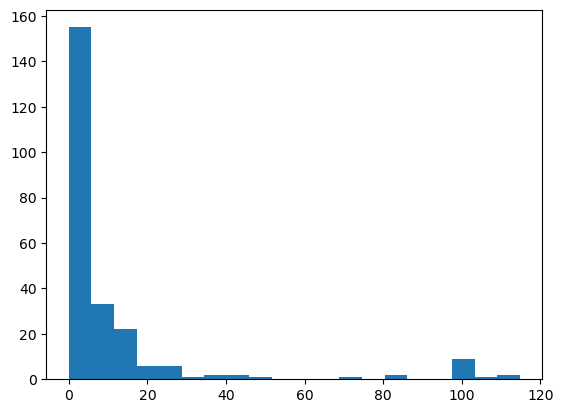

In [40]:
plt.hist(ratio2list, bins = 20)

In [52]:
cmap = plt.cm.seismic  # Example colormap
norm = colors.LogNorm(vmin=1, vmax=60, clip=True)

In [53]:
ratios1[(sort_group_id,u)]

3.3192900827769076

In [59]:
curation_id = 1

fig_sp1 = {}
fig_sp2 = {}
for sort_group_id in sort_group_ids_all:
    print("\n sort_group_id: ",sort_group_id)

    ### session 1
    peak_amp, timestamps = load_peak_amp(nwb_copy_file_name,session_name1,sort_group_id,curation_id)
    
    # colormap each cell with their continuous/fragmented preference
    color_map1 = {}
    all_units = peak_amp.keys()
    for u in all_units:
        color_map1[u] = cmap(norm(ratios1[(sort_group_id,u)]))
    
    fig_sp1[sort_group_id], _, color_map = plot_spray_window(peak_amp,color_map1,norm = norm)

    ### session 2
    peak_amp, timestamps = load_peak_amp(nwb_copy_file_name,session_name2,sort_group_id,curation_id)

    # colormap each cell with their continuous/fragmented preference
    color_map2 = {}
    all_units = peak_amp.keys()
    for u in all_units:
        color_map2[u] = cmap(norm(ratios2[(sort_group_id,u)]))
        
    fig_sp2[sort_group_id], _, _ = plot_spray_window(peak_amp,color_map2,norm = norm)


 sort_group_id:  0

 sort_group_id:  3

 sort_group_id:  7

 sort_group_id:  8

 sort_group_id:  9

 sort_group_id:  10

 sort_group_id:  12

 sort_group_id:  13

 sort_group_id:  15

 sort_group_id:  17

 sort_group_id:  18

 sort_group_id:  19

 sort_group_id:  20

 sort_group_id:  21

 sort_group_id:  23

 sort_group_id:  24

 sort_group_id:  25

 sort_group_id:  26

 sort_group_id:  27

 sort_group_id:  29

 sort_group_id:  30

 sort_group_id:  31

 sort_group_id:  32

 sort_group_id:  35

 sort_group_id:  37

 sort_group_id:  39

 sort_group_id:  40

 sort_group_id:  42

 sort_group_id:  43

 sort_group_id:  44

 sort_group_id:  46

 sort_group_id:  47

 sort_group_id:  48

 sort_group_id:  50

 sort_group_id:  53

 sort_group_id:  58

 sort_group_id:  61

 sort_group_id:  62

 sort_group_id:  63


In [60]:
def show_2plots(list_of_f, list_of_title):

    list_of_f_with_title = []
    for f_ind in range(len(list_of_f)):
        f = list_of_f[f_ind]
        title = list_of_title[f_ind]
        list_of_f_with_title.append(show_plot(f, title))
    
    backend = mpl.get_backend()
    mpl.use('agg')
    
    dpi = 200

    list_of_farrays = []
    for f in list_of_f_with_title:
        c = f.canvas
        c.draw()
        a = np.array(c.buffer_rgba())
        list_of_farrays.append(a)
        
    a = np.vstack(list_of_farrays)
    
    mpl.use(backend)
    fig,ax = plt.subplots(figsize=(24, 4 * len(list_of_f)), dpi=dpi)
    fig.subplots_adjust(0, 0, 1, 1)
    ax.set_axis_off()
    ax.matshow(a)

In [61]:
figures = []
titles = []

for sort_group_id in sort_group_ids:
    title1 = nwb_copy_file_name + " " + session_name1 + " spray window: sort group " + str(sort_group_id)
    figures.append(fig_sp1[sort_group_id])
    titles.append(title1)
    
    title2 = nwb_copy_file_name + " " + session_name2 + " spray window: sort group " + str(sort_group_id)
    figures.append(fig_sp2[sort_group_id])
    titles.append(title2)

/home/shijiegu/Documents/spyglass/src/spyglass/shijiegu/curation_manual.py:470: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  managed_fig, _ = plt.subplots(1,4,figsize=(24,4),sharex=False,sharey=False)


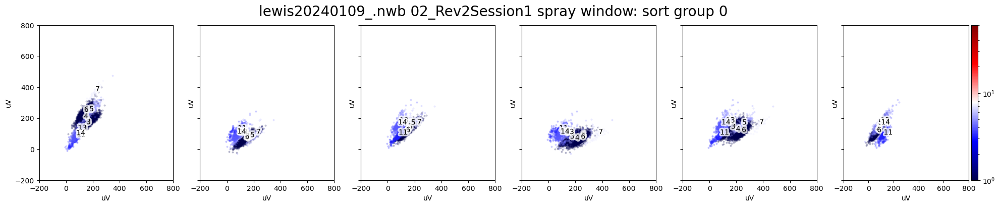

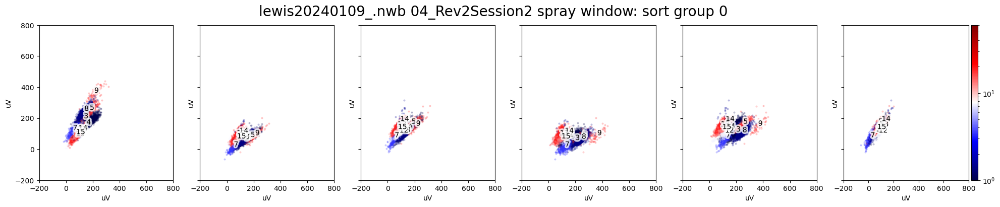

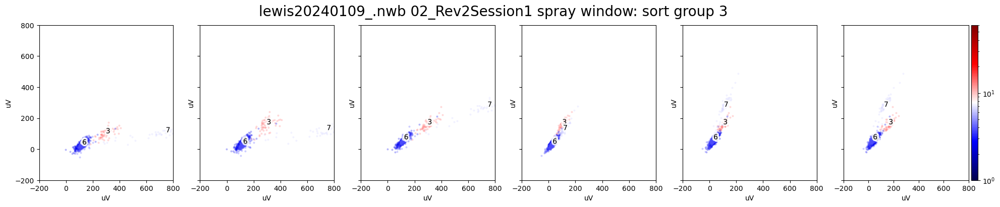

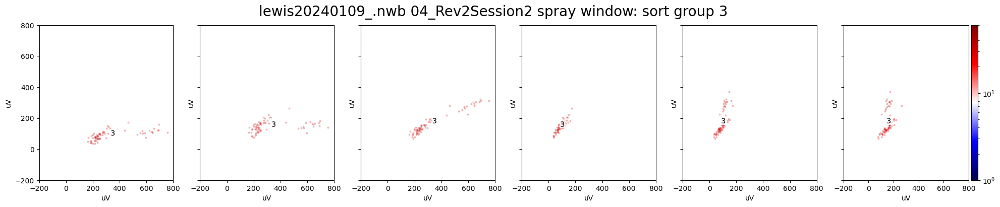

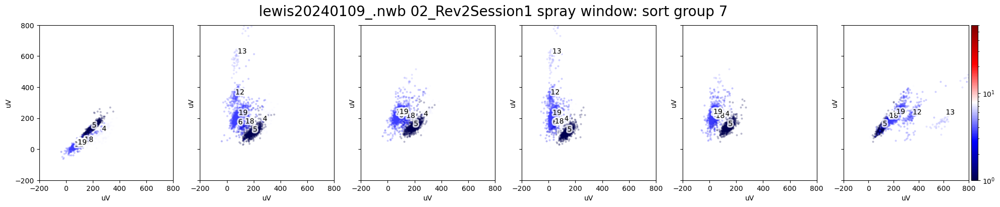

...

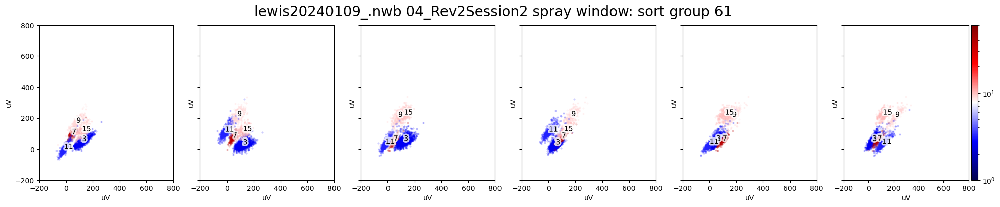

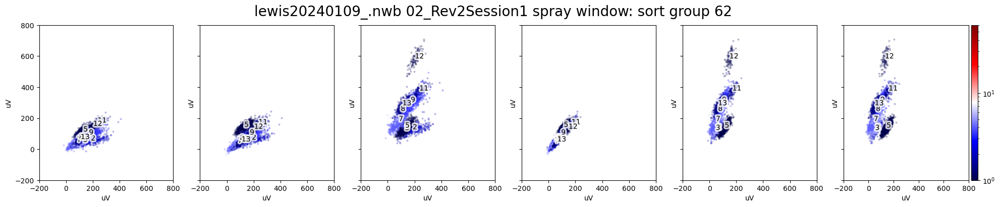

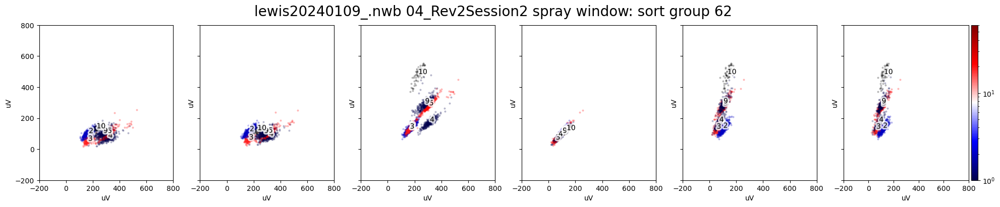

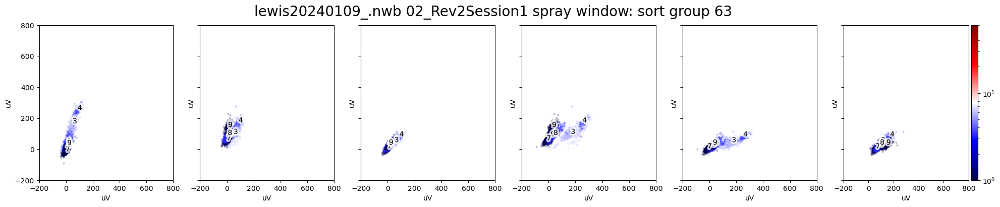

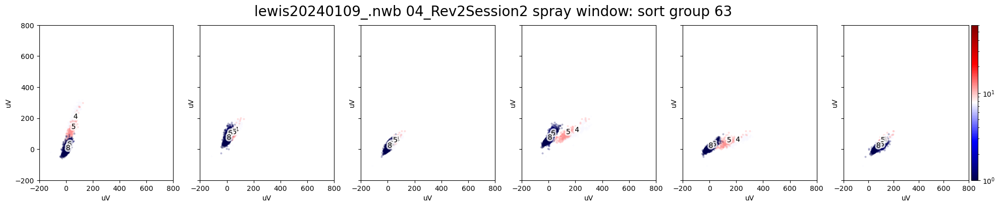

In [62]:
show_2plots(figures, titles)

#### plot all common tetrodes, instead of finding common tetrodes that have fragmented cells on both sessions

In [257]:
figures = []
titles = []

for sort_group_id in sort_group_ids_all:
    title1 = nwb_copy_file_name + " " + session_name1 + " spray window: sort group " + str(sort_group_id)
    figures.append(fig_sp1[sort_group_id])
    titles.append(title1)
    
    title2 = nwb_copy_file_name + " " + session_name2 + " spray window: sort group " + str(sort_group_id)
    figures.append(fig_sp2[sort_group_id])
    titles.append(title2)

In [258]:
show_2plots(figures, titles)

#### place field

spike num: 395
spike num: 388


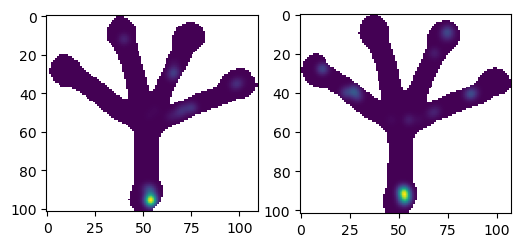

In [282]:
pairs = [(7,12),(7,16)]
f,ax = plt.subplots(1,2,figsize = (6,3))

placefield1, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name1, pos_name1, pairs[0][0], pairs[0][1])
placefield2, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name2, pos_name2, pairs[1][0], pairs[1][1])

ax[0].imshow(placefield1)
ax[1].imshow(placefield2)

spike num: 1595
spike num: 684


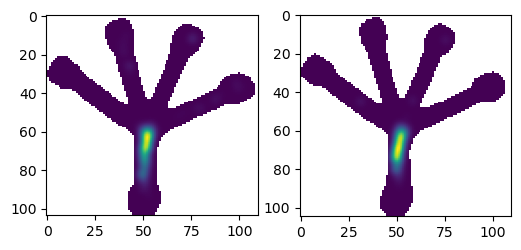

In [264]:
pairs = [(17,7),(17,14)]
f,ax = plt.subplots(1,2,figsize = (6,3))

placefield1, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name1, pos_name1, pairs[0][0], pairs[0][1])
placefield2, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name2, pos_name2, pairs[1][0], pairs[1][1])

ax[0].imshow(placefield1)
ax[1].imshow(placefield2)

spike num: 338
spike num: 466


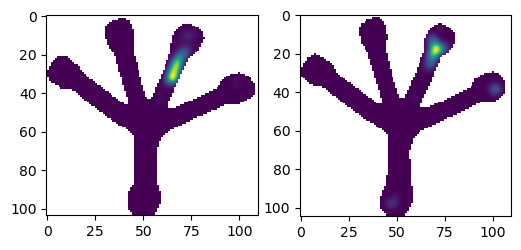

In [261]:
pairs = [(16,9),(16,10)]
f,ax = plt.subplots(1,2,figsize = (6,3))

placefield1, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name1, pos_name1, pairs[0][0], pairs[0][1])
placefield2, peak_fr, xbins, ybins, mobility_spike_count, all_spike_count = place_field(
            nwb_copy_file_name, session_name2, pos_name2, pairs[1][0], pairs[1][1])

ax[0].imshow(placefield1)
ax[1].imshow(placefield2)

In [226]:
candidates1

[(9, 4),
 (13, 12),
 (13, 13),
 (15, 19),
 (20, 18),
 (21, 7),
 (23, 13),
 (25, 11),
 (29, 4),
 (29, 8),
 (39, 4),
 (40, 3),
 (40, 11),
 (44, 4),
 (61, 7)]

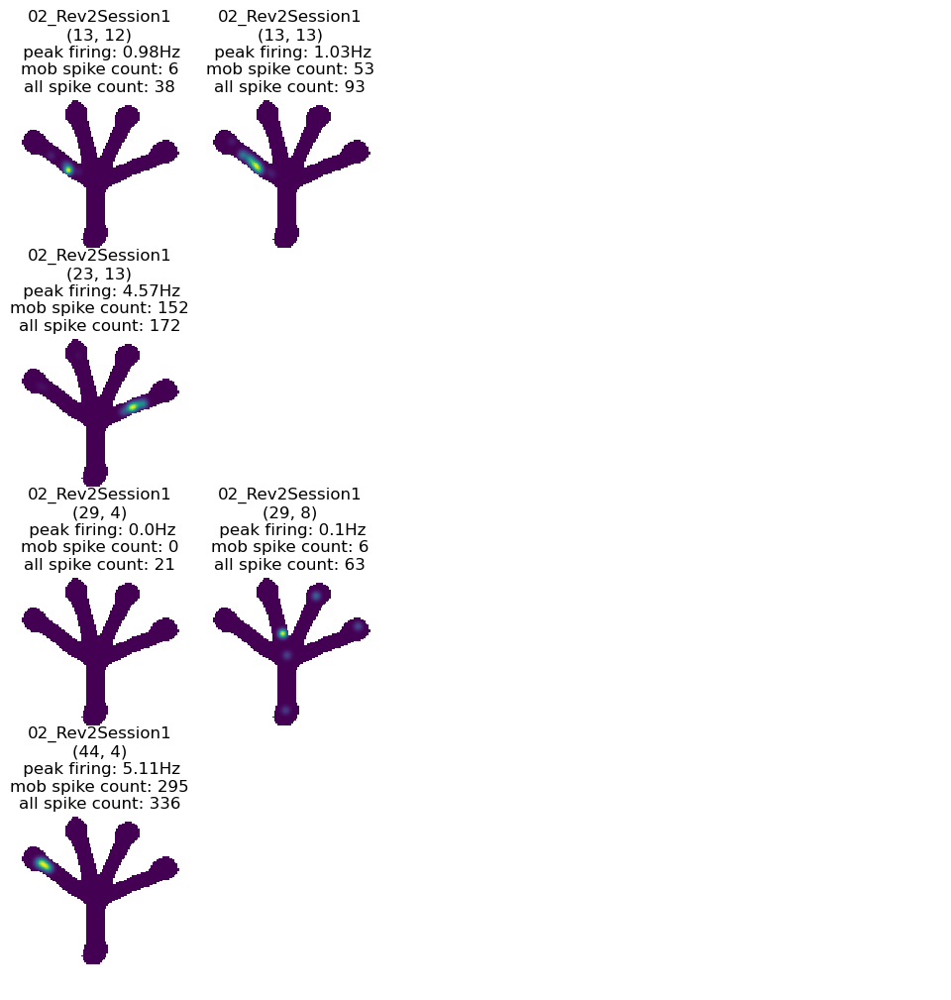

In [236]:
f,ax = plt.subplots(len(sort_group_ids),5,figsize = (12,3 * len(sort_group_ids)))

row_ind = 0
for sort_group_id in sort_group_ids:
    ind = 0
    for c1 in candidates1:
        if c1[0] == sort_group_id:
            ax[row_ind,ind].imshow(placefields1[c1])

            ax[row_ind,ind].set_title(session_name1 +"\n"+ str(c1) + "\n peak firing: " + str(np.round(peak_frs1[c1],2)) + "Hz\nmob spike count: " + str(mobility_spike_counts1[c1]) + "\nall spike count: " + str(all_spike_counts1[c1]))
            ind += 1

    for _ in range(5):
        ax[row_ind,_].set_axis_off()
    row_ind += 1
    
        

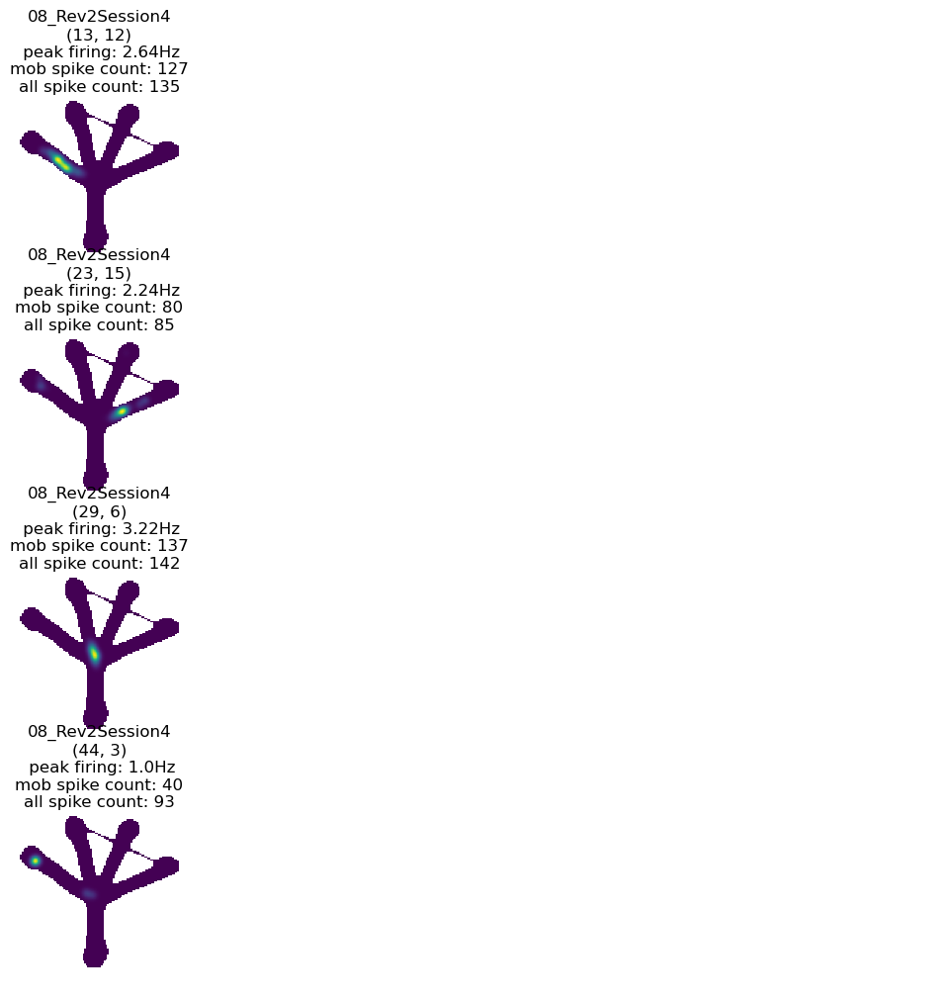

In [237]:
f,ax = plt.subplots(len(sort_group_ids),5,figsize = (12,3 * len(sort_group_ids)))

row_ind = 0
for sort_group_id in sort_group_ids:
    ind = 0
    for c1 in candidates2:
        if c1[0] == sort_group_id:
            ax[row_ind,ind].imshow(placefields2[c1])

            ax[row_ind,ind].set_title(session_name2 +"\n"+ str(c1) + "\n peak firing: " + str(np.round(peak_frs2[c1],2)) + "Hz\nmob spike count: " + str(mobility_spike_counts2[c1]) + "\nall spike count: " + str(all_spike_counts2[c1]))
            ind += 1

    for _ in range(5):
        ax[row_ind,_].set_axis_off()
    row_ind += 1